<a href="https://colab.research.google.com/github/FatimaJahara/Image-similarity-using-CLIP/blob/main/CLIP_Image_Similarity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers torch datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 25.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.1/519.1 kB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 26.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 47.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 60.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 11.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.2 MB/s eta 0:00:00


# Import Dataset

In [ ]:
from datasets import load_dataset
data = load_dataset("jamescalam/image-text-demo", split = "train")
data

Generating train split: 0 examples [00:00, ? examples/s]

Dataset({
    features: ['text', 'image'],
    num_rows: 21
})

In [ ]:
data[0]['text']

'aerial shot of futuristic city with large motorway'

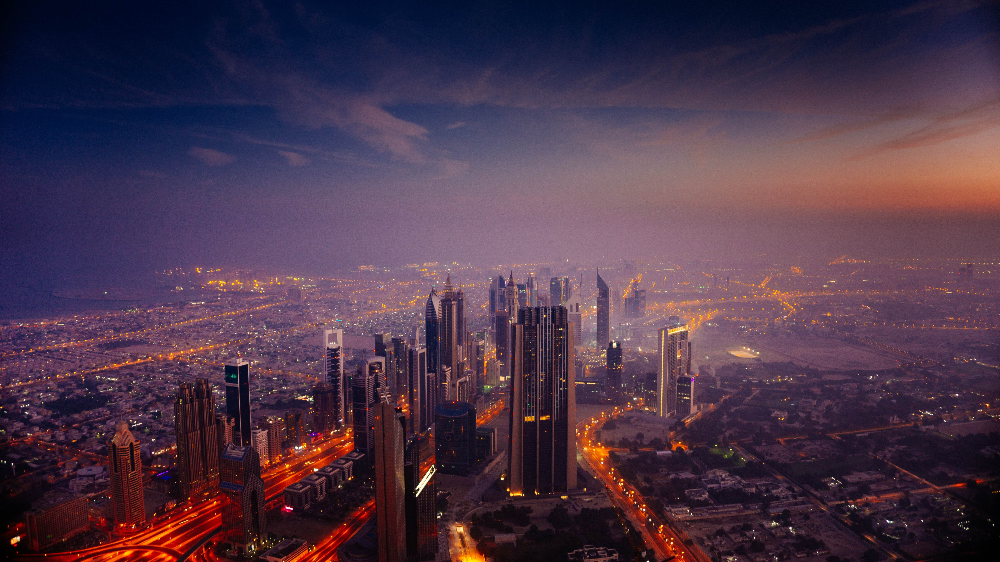

In [17]:
data[0]['image']

# CLIP Feature Extraction

In [ ]:
from transformers import CLIPProcessor, CLIPModel

model_id = "openai/clip-vit-base-patch32"
processor = CLIPProcessor.from_pretrained(model_id)
model = CLIPModel.from_pretrained(model_id)

In [ ]:
import torch
device = 'cuda' if torch.cuda.is_available() else 'cpu'
model.to(device)

CLIPModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 512)
      (position_embedding): Embedding(77, 512)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-11): 12 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=512, out_features=512, bias=True)
            (v_proj): Linear(in_features=512, out_features=512, bias=True)
            (q_proj): Linear(in_features=512, out_features=512, bias=True)
            (out_proj): Linear(in_features=512, out_features=512, bias=True)
          )
          (layer_norm1): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): QuickGELUActivation()
            (fc1): Linear(in_features=512, out_features=2048, bias=True)
            (fc2): Linear(in_features=2048, out_features=512, bias=True)
          )
          (layer_norm2): LayerNorm((512,), eps=1e-05,

## Text Encoding

In [70]:
text = data['text']

tokens = processor(text = text,
                   padding = True,
                   images = None,
                   return_tensors = 'pt').to(device)

In [71]:
tokens.keys()

dict_keys(['input_ids', 'attention_mask'])

In [72]:
text_emb = model.get_text_features(**tokens)
print(text_emb.shape)

torch.Size([21, 512])


In [73]:
import numpy as np
text_emb = text_emb.detach().cpu().numpy()

text_emb = text_emb.T/np.linalg.norm(text_emb, axis = 1)
text_emb = text_emb.T

In [74]:
text_emb.shape

(21, 512)

## Image Encoding

In [75]:
data['image'][0].size

(6000, 3376)

In [76]:
image_batch = data['image']

images = processor(text = None,
                   images = image_batch,
                   return_tensors = 'pt')['pixel_values'].to(device)
images.shape

torch.Size([21, 3, 224, 224])

In [77]:
img_emb = model.get_image_features(images)
print(img_emb.shape)

torch.Size([21, 512])


In [78]:
img_emb = img_emb.detach().cpu().numpy()

In [79]:
img_emb = img_emb.T/np.linalg.norm(img_emb, axis = 1)
img_emb = img_emb.T

In [80]:
img_emb.shape

(21, 512)

# Calculating Similarity

## Cosine Similarity

In [81]:
np.dot(text_emb, img_emb.T).shape

(21, 21)

In [82]:
norm(text_emb, axis = 1).shape

(21,)

In [83]:
from numpy.linalg import norm

cosine_sim = np.dot(text_emb, img_emb.T)/(norm(text_emb, axis = 1) * norm(img_emb, axis = 1))
cosine_sim

array([[0.25730866, 0.22222461, 0.12015544, 0.11618056, 0.09090155,
        0.23241742, 0.21191932, 0.12381889, 0.09861559, 0.08168156,
        0.09774599, 0.10721102, 0.16839893, 0.19027273, 0.20974635,
        0.09954322, 0.21827188, 0.07896101, 0.13110673, 0.0906281 ,
        0.10500701],
       [0.2880543 , 0.28310975, 0.1404627 , 0.1206991 , 0.11765084,
        0.24992688, 0.21049874, 0.13621731, 0.11265233, 0.10125002,
        0.11584609, 0.11658918, 0.22987737, 0.21608083, 0.21514572,
        0.11406491, 0.26135692, 0.13181427, 0.14080316, 0.10133142,
        0.13083231],
       [0.12190286, 0.10138588, 0.31832573, 0.26350752, 0.18533987,
        0.1281327 , 0.13685766, 0.25763866, 0.21936125, 0.20466475,
        0.20260637, 0.24301215, 0.11373436, 0.15655015, 0.13870516,
        0.19228385, 0.12079646, 0.16140398, 0.26347518, 0.18691494,
        0.17114899],
       [0.10385769, 0.09180891, 0.24818651, 0.3324807 , 0.12515935,
        0.11742835, 0.13454019, 0.22132598, 0.1763627

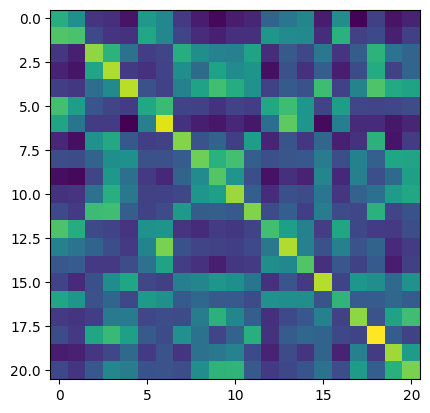

In [84]:
import matplotlib.pyplot as plt

plt.imshow(cosine_sim)
plt.show()

## Dot Similarity

In [85]:
dot_sim = np.dot(text_emb, img_emb.T)

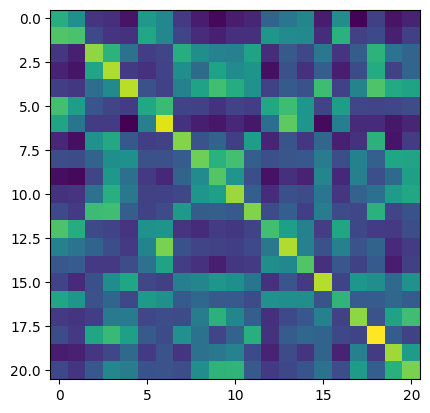

In [86]:
plt.imshow(dot_sim)
plt.show()

In [87]:
diff = cosine_sim - dot_sim
diff.min(), diff.max()

(0.0, 2.9802322e-08)